# Read data #

In [1]:
from google.colab import drive
import matplotlib.pyplot as plt
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip "/content/drive/MyDrive/frames_zip/data.zip" -d "/content"

Strumieniowane dane wyjściowe obcięte do 5000 ostatnich wierszy.
 extracting: /content/20000.png      
 extracting: /content/20001.png      
 extracting: /content/20002.png      
 extracting: /content/20003.png      
 extracting: /content/20004.png      
 extracting: /content/20005.png      
 extracting: /content/20006.png      
 extracting: /content/20007.png      
 extracting: /content/20008.png      
 extracting: /content/20009.png      
 extracting: /content/20010.png      
 extracting: /content/20011.png      
 extracting: /content/20012.png      
 extracting: /content/20013.png      
 extracting: /content/20014.png      
 extracting: /content/20015.png      
 extracting: /content/20016.png      
 extracting: /content/20017.png      
 extracting: /content/20018.png      
 extracting: /content/20019.png      
 extracting: /content/20020.png      
 extracting: /content/20021.png      
 extracting: /content/20022.png      
 extracting: /content/20023.png      
 extracting: /content/2

In [3]:
DATASET_PATH = "/content/"

In [4]:
import torch
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms

import numpy as np
import pandas as pd

from PIL import Image

In [5]:
parameters = pd.read_csv("/content/drive/MyDrive/frames_zip/parameters.csv", index_col=False)

In [6]:
parameters.head()

,width,height,epsilon,ring_center_width,ring_center_height,min_brightness,max_brightness,used_noise,filename
0,640,480,0.0,324,238,80,210,128,00000.png
1,640,480,0.0,324,239,80,210,381,00001.png
2,640,480,0.0,319,235,80,210,252,00002.png
3,640,480,0.0,326,238,80,210,174,00003.png
4,640,480,0.0,314,241,80,210,291,00004.png


In [7]:
class ImageDataset(Dataset):
    def __init__(self, path: str, parameters: pd.DataFrame, transform=None) -> None:
        self.image_paths = np.array([path + filename for filename in parameters['filename'].to_numpy()])
        self.labels = parameters['epsilon'].to_numpy()
        self.transform = transform
    
    def __getitem__(self, inx):
        image_path = self.image_paths[inx]
        label_float_epsilon = self.labels[inx]
        target = np.zeros(shape=(1000,))
        target[int(label_float_epsilon*1000)] = 1
        image = Image.open(image_path)
        image = np.array(image)
        # repeat grayscale value three times for all RGB channels
        image = np.repeat(image[..., np.newaxis], 3, -1)
        if self.transform:
            image = self.transform(image)
        return image, torch.from_numpy(target)
        
    def __len__(self):
        return len(self.image_paths)

In [8]:
from sklearn.model_selection import train_test_split

In [9]:
# Testing splitting with sklearn to properly stratify data
train_df, valid_df = train_test_split(parameters, test_size=3750, random_state=12, shuffle=True, stratify=parameters['epsilon'])
train_df, test_df = train_test_split(train_df, test_size=3750, random_state=12, shuffle=True, stratify=train_df['epsilon'])

In [10]:
print("Unique epsilons in train set: ", len(train_df.groupby(['epsilon'])['epsilon'].count()), ". Number of images: ", len(train_df))
print("Unique epsilons in validation set: ", len(valid_df.groupby(['epsilon'])['epsilon'].count()), ". Number of images: ", len(valid_df))
print("Unique epsilons in test set: ", len(test_df.groupby(['epsilon'])['epsilon'].count()), ". Number of images: ", len(test_df))

Unique epsilons in train set:  1000 . Number of images:  17500
Unique epsilons in validation set:  1000 . Number of images:  3750
Unique epsilons in test set:  1000 . Number of images:  3750


In [11]:
#Transfor image array into pytorch tensor and normalize it
transform = transforms.Compose([
    transforms.ToPILImage(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

In [12]:
# Load dataframes into pytorch datasets
training_dataset = ImageDataset(path=DATASET_PATH, parameters=train_df, transform=transform)
validation_dataset = ImageDataset(path=DATASET_PATH, parameters=valid_df, transform=transform)

In [13]:
test_dataset = ImageDataset(path=DATASET_PATH, parameters=test_df, transform=transform)

In [14]:
# Load datasets into pytorch dataloaders
training_loader = DataLoader(training_dataset, batch_size=16, shuffle=True, num_workers=0)
validation_loader = DataLoader(validation_dataset, batch_size=16, shuffle=True, num_workers=0)

In [15]:
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=True, num_workers=0)

In [16]:
def cyclic_MAE(outputs, targets):
    x1 = torch.minimum(torch.abs(outputs-targets), torch.minimum(torch.abs(outputs-targets+1), torch.abs(outputs-targets-1)))
    return torch.mean(x1)

In [17]:
x1 = np.array([0.002, 0.004, 0.006, 0.6])
x2 = np.array([0.004, 0.998, 0.008, 0.4])
cyclic_MAE(torch.from_numpy(x1).float(), torch.from_numpy(x2).float())

tensor(0.0525)

In [18]:
import torch.nn as nn
from torchvision import models
import torch.optim as optim
from tqdm import tqdm

In [19]:
model = models.resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 130MB/s]


In [20]:
classifier = nn.Sequential(
    nn.Linear(2048, 2048),
    nn.ReLU(),
    nn.Dropout(0.3),
    nn.ReLU(),
    nn.Linear(2048, 1000)
)

In [21]:
model.fc = classifier

In [22]:
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [24]:
model_path = "/content/drive/MyDrive/resnet50.pth"

In [26]:
model.load_state_dict(torch.load(model_path, map_location=torch.device('cpu')))
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

# Visualizing feature maps

In [27]:
model_weights =[]
conv_layers = []
# get all the model children as list
model_children = list(model.children())
#counter to keep count of the conv layers
counter = 0
#append all the conv layers and their respective wights to the list
for i in range(len(model_children)):
    if type(model_children[i]) == nn.Conv2d:
        counter+=1
        model_weights.append(model_children[i].weight)
        conv_layers.append(model_children[i])
    elif type(model_children[i]) == nn.Sequential:
        for j in range(len(model_children[i])):
            for child in model_children[i][j].children():
                if type(child) == nn.Conv2d:
                    counter+=1
                    model_weights.append(child.weight)
                    conv_layers.append(child)
print(f"Total convolution layers: {counter}")
print("conv_layers")

Total convolution layers: 49
conv_layers


In [28]:
loader = iter(test_loader)
batch = next(loader)[0]
batch.shape
image = batch[0]
image = image.unsqueeze(0)

In [29]:
outputs = []
names = []
for layer in conv_layers[0:]:
    image = layer(image)
    outputs.append(image)
    names.append(str(layer))
print(len(outputs))
#print feature_maps
for feature_map in outputs:
    print(feature_map.shape)

49
torch.Size([1, 64, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 256, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 256, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 64, 112, 112])
torch.Size([1, 256, 112, 112])
torch.Size([1, 128, 112, 112])
torch.Size([1, 128, 56, 56])
torch.Size([1, 512, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 512, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 512, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 128, 56, 56])
torch.Size([1, 512, 56, 56])
torch.Size([1, 256, 56, 56])
torch.Size([1, 256, 28, 28])
torch.Size([1, 1024, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 1024, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 1024, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 256, 28, 28])
torch.Size([1, 1024, 2

In [30]:
processed = []
for feature_map in outputs:
    feature_map = feature_map.squeeze(0)
    gray_scale = torch.sum(feature_map,0)
    gray_scale = gray_scale / feature_map.shape[0]
    processed.append(gray_scale.data.cpu().numpy())
for fm in processed:
    print(fm.shape)

(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(112, 112)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(56, 56)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(28, 28)
(14, 14)
(14, 14)
(14, 14)
(14, 14)
(14, 14)
(14, 14)
(14, 14)
(14, 14)


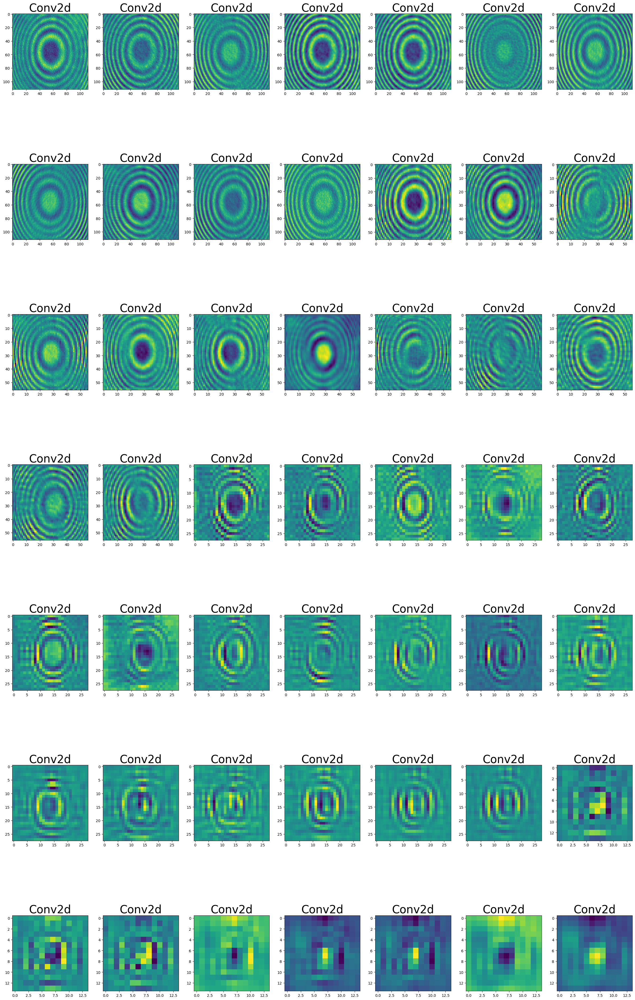

In [31]:
fig = plt.figure(figsize=(30, 50))
for i in range(len(processed)):
    a = fig.add_subplot(7, 7, i+1)
    imgplot = plt.imshow(processed[i])
    # a.axis("off")
    a.set_title(names[i].split('(')[0], fontsize=30)

# Captum insights #

In [ ]:
from captum.insights import AttributionVisualizer, Batch
from captum.insights.attr_vis.features import ImageFeature

In [ ]:
def baseline_func(input):
    return input * 0

In [ ]:
def formatted_data_iter(loader):
    dataloader = iter(
       loader
    )
    while True:
        images, labels = next(dataloader)
        yield Batch(inputs=images, labels=labels)

In [ ]:
def get_classes():
  classes = np.identity(1000)
  return classes.tolist()

In [ ]:
visualizer = AttributionVisualizer(
    models=[model],
    score_func=lambda o: torch.nn.functional.softmax(o, 1),
    classes=get_classes(),
    features=[
        ImageFeature(
            "Photo",
            baseline_transforms=[baseline_func],
            input_transforms=None,

        )
    ],
    dataset=formatted_data_iter(test_loader),
)

In [ ]:
visualizer.render()

CaptumInsights(insights_config={'classes': [[1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, …

Output()

In [ ]:
from google.colab import output
output.enable_custom_widget_manager()